In [9]:
import os
from Bio import SeqIO
import numpy as np
import csv

# File paths
genome_file_path = '/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/project/Selected_1000_Unique_COVID19_Genomes_Asia.fasta'
output_dir = '/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/individual_genomes'
alignment_output_dir = '/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results'
mutation_matrix_csv = '/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/mutation_matrix.csv'

# Create necessary directories
os.makedirs(output_dir, exist_ok=True)
os.makedirs(alignment_output_dir, exist_ok=True)

# Read genomes from the FASTA file
genome_records = list(SeqIO.parse(genome_file_path, "fasta"))
for record in genome_records:
    gene_id = record.id
    output_file = os.path.join(output_dir, f"{gene_id}.fasta")
    SeqIO.write(record, output_file, "fasta")

# Ensure that NC_045512.2 is present
if not any(record.id == 'NC_045512.2' for record in genome_records):
    raise ValueError("NC_045512.2 is not found in the input genome file.")

# Save NC_045512.2 to the output directory if not already done
reference_genome_record = next(record for record in genome_records if record.id == 'NC_045512.2')
reference_genome_path = os.path.join(output_dir, f"{reference_genome_record.id}.fasta")
SeqIO.write(reference_genome_record, reference_genome_path, "fasta")

# Perform pairwise alignment with NC_045512.2 against all other genomes
reference_genome = 'NC_045512.2'
for record in genome_records:
    if record.id != reference_genome:
        output_prefix = os.path.join(alignment_output_dir, f"{record.id}")
        genome1_path = os.path.join(output_dir, f"{reference_genome}.fasta")
        genome2_path = os.path.join(output_dir, f"{record.id}.fasta")

        # GATEkeeper alignment command
        command = f"/Users/mohanavenkataphaneendrareddyalla/GATEkeeper/bin/GATEkeeper -r {genome1_path} -q {genome2_path} -o {output_prefix} -fmt 1"
        os.system(command)

# Parsing VCF files and creating mutation matrix
def parse_vcf(vcf_file):
    with open(vcf_file) as file:
        return {(line.split('\t')[0], int(line.split('\t')[1]), line.split('\t')[3], line.split('\t')[4]) 
                for line in file if not line.startswith('#')}

vcf_directory = alignment_output_dir  # Use the correct directory for VCF files
vcf_files = [os.path.join(vcf_directory, f) for f in os.listdir(vcf_directory) if f.endswith('.vcf')]
mutation_sets = [parse_vcf(vcf) for vcf in vcf_files]
mutation_matrix = np.array([[len(m1.symmetric_difference(m2)) for m2 in mutation_sets] for m1 in mutation_sets])

# Save mutation matrix to CSV
labels = [os.path.splitext(os.path.basename(f))[0] for f in vcf_files]
output_csv = mutation_matrix_csv  # Use the correct CSV file path
with open(output_csv, 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow([""] + labels)
    writer.writerows([[label] + row.tolist() for label, row in zip(labels, mutation_matrix)])

print(f"Mutation matrix saved to {output_csv}")

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ283576.1...
		Seed exploration: 29753 / 29753 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29690), ANI=99.37%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ283576.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29690) ANI=99.37%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 132 SNVs, 1 insertions, and 7 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ283576.1.vcf].

Step1. Load the two gen

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

4 / 29744 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29690), ANI=99.40%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016220.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29690) ANI=99.40%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 125 SNVs, 1 insertions, and 7 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016220.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS016221.1...
		Seed exploration: 29786 / 29786 (100%)...
		S

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS016228.1...
		Seed exploration: 29753 / 29753 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29721), ANI=99.39%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016228.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29721) ANI=99.39%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 128 SNVs, 1 insertions, and 7 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016228.1.vcf].

Step1. Load the two gen

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29705) ANI=99.61%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 82 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ213095.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ202184.1...
		Seed exploration: 29753 / 29753 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29690), ANI=99.39%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ202184.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29782) ANI=99.93%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 20 SNVs, 0 insertions, and 0 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016061.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS016063.1...
		Seed exploration: 29782 / 29782 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29782), ANI=99.93%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016063.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index


	Alignment#=1 (total alignment length=29782) ANI=99.83%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 31 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016118.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS016119.1...
		Seed exploration: 29763 / 29763 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29782), ANI=99.83%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016119.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total al

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29782) ANI=99.83%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 31 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016175.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS016177.1...
		Seed exploration: 29763 / 29763 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29782), ANI=99.83%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016177.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ101691.1...
		Seed exploration: 29772 / 29772 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.56%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ101691.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.56%, unique alignment#=1
	It took 1 seconds for genome sequence alignment.

GATEkeeper identifies 101 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ101691.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference seq

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ101846.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.55%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ101846.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.55%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 102 SNVs, 0 insertions, and 5 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ101846.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference seq

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Seed exploration: 29801 / 29801 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29729), ANI=99.57%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ102134.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29729) ANI=99.57%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 98 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ102134.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ102163.1...
		Seed exploration: 2977

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Seed exploration: 29772 / 29772 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.57%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ102403.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.57%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 98 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ102403.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ102408.1...
		Seed exploration: 2977

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.56%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 101 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ102487.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ102489.1...
		Seed exploration: 29772 / 29772 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.58%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ102489.1.maf)
		Identify sequence var

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.57%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 98 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ102897.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ102916.1...
		Seed exploration: 29762 / 29762 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.53%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ102916.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.58%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 97 SNVs, 0 insertions, and 3 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103756.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ103766.1...
		Seed exploration: 29775 / 29775 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.58%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103766.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ103874.1...
		Seed exploration: 29742 / 29742 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.60%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103874.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.60%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 85 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103874.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ103891.1...
		Seed exploration: 29844 / 29844 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29733), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103891.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29733) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103891.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index


	Alignment#=1 (total alignment length=29733) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103894.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ103895.1...
		Seed exploration: 29655 / 29655 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29688), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103895.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total al

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ103933.1...
		Seed exploration: 29757 / 29757 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29702), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103933.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29702) ANI=99.61%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 83 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103933.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ103954.1...
		Seed exploration: 29756 / 29756 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29682), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103954.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29682) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103954.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29733) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103960.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ103962.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ103962.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

alignments (length = 29709), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ104018.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.61%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 84 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ104018.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ104019.1...
		Seed exploration: 29631 / 29631 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 296

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29731) ANI=99.57%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 96 SNVs, 0 insertions, and 5 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ104706.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ104721.1...
		Seed exploration: 29785 / 29785 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29730), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ104721.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105220.1...
		Seed exploration: 29625 / 29625 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29658), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105220.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29658) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 78 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105220.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105239.1...
		Seed exploration: 29625 / 29625 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29658), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105239.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29658) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 78 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105239.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105252.1...
		Seed exploration: 29624 / 29624 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29657), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105252.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29657) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 78 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105252.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105264.1...
		Seed exploration: 29674 / 29674 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29707), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105264.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29707) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105264.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105275.1...
		Seed exploration: 29624 / 29624 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29657), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105275.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29657) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 78 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105275.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105293.1...
		Seed exploration: 29783 / 29783 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29730), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105293.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29730) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105293.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105302.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105302.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105302.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105319.1...
		Seed exploration: 29631 / 29631 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29664), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105319.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29664) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105319.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105328.1...
		Seed exploration: 29634 / 29634 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29667), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105328.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29667) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105328.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29707) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105340.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105342.1...
		Seed exploration: 29669 / 29669 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29702), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105342.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105358.1...
		Seed exploration: 29682 / 29682 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29715), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105358.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29715) ANI=99.61%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 84 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105358.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105367.1...
		Seed exploration: 29786 / 29786 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29733), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105367.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29733) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105367.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105395.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105395.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 77 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105395.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105405.1...
		Seed exploration: 29623 / 29623 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29656), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105405.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29656) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105405.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105420.1...
		Seed exploration: 29745 / 29745 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29696), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105420.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29696) ANI=99.63%, unique alignment#=1
	It took 1 seconds for genome sequence alignment.

GATEkeeper identifies 78 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105420.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index


		Genreate sequence alignment...
		Produce 1 local alignments (length = 29655), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105434.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29655) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105434.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105435.1...
		Seed exploration: 29737 / 29737 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence ali

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105447.1...
		Seed exploration: 29624 / 29624 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29657), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105447.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29657) ANI=99.61%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 82 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105447.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105460.1...
		Seed exploration: 29624 / 29624 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29657), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105460.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29657) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 78 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105460.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105479.1...
		Seed exploration: 29732 / 29732 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29683), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105479.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29683) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105479.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105495.1...
		Seed exploration: 29625 / 29625 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29658), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105495.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29658) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105495.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105513.1...
		Seed exploration: 29625 / 29625 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29658), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105513.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29658) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105513.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105523.1...
		Seed exploration: 29671 / 29671 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29704), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105523.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29704) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105523.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105539.1...
		Seed exploration: 29624 / 29624 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29657), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105539.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29657) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105539.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105549.1...
		Seed exploration: 29625 / 29625 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29658), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105549.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29658) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 78 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105549.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29658) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105562.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105563.1...
		Seed exploration: 29624 / 29624 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29657), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105563.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105574.1...
		Seed exploration: 29628 / 29628 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29661), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105574.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29661) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105574.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105599.1...
		Seed exploration: 29621 / 29621 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29654), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105599.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29654) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105599.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105614.1...
		Seed exploration: 29623 / 29623 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29656), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105614.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29656) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 78 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105614.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Produce 1 local alignments (length = 29658), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105630.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29658) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105630.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105631.1...
		Seed exploration: 29625 / 29625 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignm

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105642.1...
		Seed exploration: 29625 / 29625 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29658), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105642.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29658) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105642.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105661.1...
		Seed exploration: 29628 / 29628 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29661), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105661.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29661) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105661.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105676.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105677.1...
		Seed exploration: 29768 / 29768 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105677.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105685.1...
		Seed exploration: 29768 / 29768 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105685.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105685.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105696.1...
		Seed exploration: 29721 / 29721 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105696.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105696.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105705.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105705.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105705.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105715.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105715.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105715.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105726.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105726.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105726.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105734.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105734.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105734.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105744.1...
		Seed exploration: 29767 / 29767 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105744.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105744.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105759.1...
		Seed exploration: 29768 / 29768 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105759.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 79 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105759.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105778.1...
		Seed exploration: 29745 / 29745 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105778.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105778.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105789.1...
		Seed exploration: 29768 / 29768 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105789.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.61%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 83 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105789.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105799.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105799.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105800.1...
		Seed exploration: 29702 / 29702 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignm

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105849.1...
		Seed exploration: 29745 / 29745 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105849.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105849.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105858.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105858.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105858.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105925.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105925.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.61%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 82 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105925.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105934.1...
		Seed exploration: 29745 / 29745 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105934.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.61%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 84 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105934.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Produce 1 local alignments (length = 29716), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105943.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29716) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105943.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105944.1...
		Seed exploration: 29634 / 29634 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignm

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105962.1...
		Seed exploration: 29775 / 29775 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.59%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105962.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.59%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 96 SNVs, 0 insertions, and 3 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105962.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105975.1...
		Seed exploration: 29634 / 29634 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29667), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105975.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29667) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105975.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ105992.1...
		Seed exploration: 29794 / 29794 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29733), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105992.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29733) ANI=99.61%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 84 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ105992.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106004.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106004.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.61%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 82 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106004.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106016.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106017.1...
		Seed exploration: 29745 / 29745 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106017.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106026.1...
		Seed exploration: 29870 / 29870 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29903), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106026.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29903) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106026.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106049.1...
		Seed exploration: 29802 / 29802 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29733), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106049.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29733) ANI=99.61%, unique alignment#=1
	It took 1 seconds for genome sequence alignment.

GATEkeeper identifies 82 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106049.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106059.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106059.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106059.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106072.1...
		Seed exploration: 29753 / 29753 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29721), ANI=99.61%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106072.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29721) ANI=99.61%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 5 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106072.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106088.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106088.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 78 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106088.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106105.1...
		Seed exploration: 29799 / 29799 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29733), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106105.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29733) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106105.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106120.1...
		Seed exploration: 29634 / 29634 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29667), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106120.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29667) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 78 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106120.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106129.1...
		Seed exploration: 29682 / 29682 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29715), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106129.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29715) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106129.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106142.1...
		Seed exploration: 29721 / 29721 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106142.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 76 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106142.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29656) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 81 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106167.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106168.1...
		Seed exploration: 29615 / 29615 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29648), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106168.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106181.1...
		Seed exploration: 29623 / 29623 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29656), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106181.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29656) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106181.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106195.1...
		Seed exploration: 29768 / 29768 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106195.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 78 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106195.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106205.1...
		Seed exploration: 29742 / 29742 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106205.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 80 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106205.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106213.1...
		Seed exploration: 29769 / 29769 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29709), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106213.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29709) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 77 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106213.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: PQ106223.1...
		Seed exploration: 29756 / 29756 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29716), ANI=99.56%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106223.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29716) ANI=99.56%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 82 SNVs, 0 insertions, and 5 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/PQ106223.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS016038.1...
		Seed exploration: 29790 / 29790 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29740), ANI=99.39%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016038.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29740) ANI=99.39%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 127 SNVs, 1 insertions, and 7 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016038.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference seq

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS016047.1...
		Seed exploration: 29778 / 29778 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29721), ANI=99.40%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016047.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29721) ANI=99.40%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 123 SNVs, 1 insertions, and 7 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS016047.1.vcf].

Step1. Load the two gen

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS010910.1...
		Seed exploration: 29786 / 29786 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29825), ANI=99.64%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS010910.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29825) ANI=99.64%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 58 SNVs, 1 insertions, and 6 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS010910.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS010933.1...
		Seed exploration: 29786 / 29786 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29825), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS010933.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29825) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 62 SNVs, 1 insertions, and 6 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS010933.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29827) ANI=99.50%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 59 SNVs, 2 insertions, and 6 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS011386.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS011428.1...
		Seed exploration: 29747 / 29747 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29786), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS011428.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS013920.1...
		Seed exploration: 29598 / 29598 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29579), ANI=99.65%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS013920.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29579) ANI=99.65%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 70 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS013920.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS014370.1...
		Seed exploration: 29536 / 29536 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29568), ANI=99.62%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS014370.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29568) ANI=99.62%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 78 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS014370.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS014483.1...
		Seed exploration: 29445 / 29445 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29478), ANI=99.64%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS014483.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29478) ANI=99.64%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 72 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS014483.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS014737.1...
		Seed exploration: 29580 / 29580 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29613), ANI=99.65%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS014737.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29613) ANI=99.65%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 70 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS014737.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29612) ANI=99.65%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 70 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS014774.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS014780.1...
		Seed exploration: 29443 / 29443 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29476), ANI=99.66%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS014780.1.maf)
		Identify sequence vari

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS014822.1...
		Seed exploration: 29723 / 29723 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29782), ANI=99.55%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS014822.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29782) ANI=99.55%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 70 SNVs, 1 insertions, and 5 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS014822.1.vcf].

Step1. Load the two geno

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index

	Load the reference sequences (1 chromosome)
Step2. Sequence analysis for all query chromosomes
	Process query chromsomoe: BS015033.1...
		Seed exploration: 29493 / 29493 (100%)...
		Seed clustering and chaining...
		Fix overlapping seeds and close gaps between gaps...
		Genreate sequence alignment...
		Produce 1 local alignments (length = 29526), ANI=99.63%
		Output alignments for query sequence (/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS015033.1.maf)
		Identify sequence variants for query sequence...

	Alignment#=1 (total alignment length=29526) ANI=99.63%, unique alignment#=1
	It took 0 seconds for genome sequence alignment.

GATEkeeper identifies 75 SNVs, 0 insertions, and 4 deletions [/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results/BS015033.1.vcf].

Step1. Load the two genome sequences...
	Load the query sequences (1 chromosome)
	Load the reference sequ

[bwt_index] Pack FASTA... 0.00 sec
[bwt_index] Construct BWT for the packed sequence...
[BWTIncCreate] textLength=59806, availableWord=76494
[bwt_gen] Finished constructing BWT in 5 iterations.
[bwt_index] 0.00 seconds elapse.
[bwt_index] Update BWT... 0.00 sec
[bwt_index] Pack forward-only FASTA... 0.00 sec
[bwt_index] Construct SA from BWT and Occ... 0.00 sec
Mutation matrix saved to /Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/mutation_matrix.csv


In [3]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import nbinom
import numpy as np

# Directory containing VCF files
vcf_folder = '/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/Project_final/alignment_results'

# Function to parse a VCF file
def parse_vcf(file_path):
    mutation_data = []
    with open(file_path, 'r') as file:
        for line in file:
            if line.startswith('#'):
                continue
            parts = line.strip().split('\t')
            chrom, pos, ref, alt, info = parts[0], int(parts[1]), parts[3], parts[4], parts[7]
            mutation_type = info.split('=')[1]
            mutation_data.append([chrom, pos, ref, alt, mutation_type])
    return mutation_data

# Collect data from all VCF files
all_mutation_data = []
for file_name in os.listdir(vcf_folder):
    if file_name.endswith('.vcf'):
        file_path = os.path.join(vcf_folder, file_name)
        all_mutation_data.extend(parse_vcf(file_path))

# Create a DataFrame for all mutations
df = pd.DataFrame(all_mutation_data, columns=['CHROM', 'POS', 'REF', 'ALT', 'TYPE'])

# Separate SNPs and Indels
snp_data = df[df['TYPE'] == 'SUBSTITUTE']
indel_data = df[df['TYPE'] != 'SUBSTITUTE']


mutation_freq = df['POS'].value_counts().sort_index()
snp_freq = snp_data['POS'].value_counts().sort_index()
indel_freq = indel_data['POS'].value_counts().sort_index()

In [4]:
print("\nDescriptive Statistics:")
print(df.describe())


Descriptive Statistics:
                POS
count  85009.000000
mean   19194.377807
std     8242.891541
min       21.000000
25%    12310.000000
50%    22688.000000
75%    24469.000000
max    29868.000000


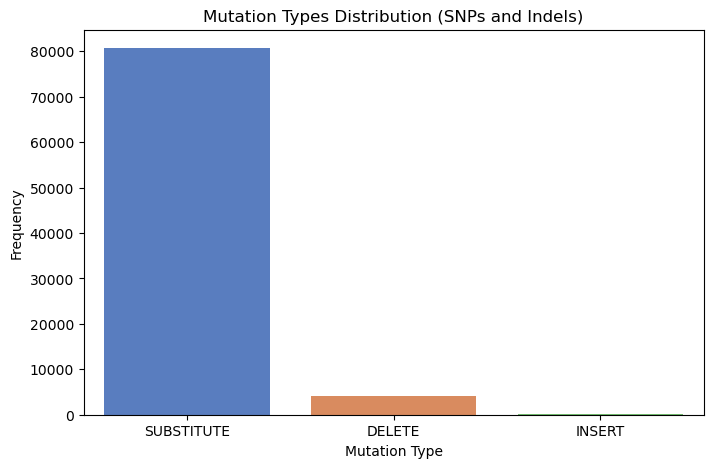

In [5]:
# Count mutation types
mutation_counts = df["TYPE"].value_counts()

# Bar plot for mutation types
plt.figure(figsize=(8, 5))
sns.barplot(x=mutation_counts.index, y=mutation_counts.values, palette="muted")
plt.title("Mutation Types Distribution (SNPs and Indels)")
plt.xlabel("Mutation Type")
plt.ylabel("Frequency")
plt.show()

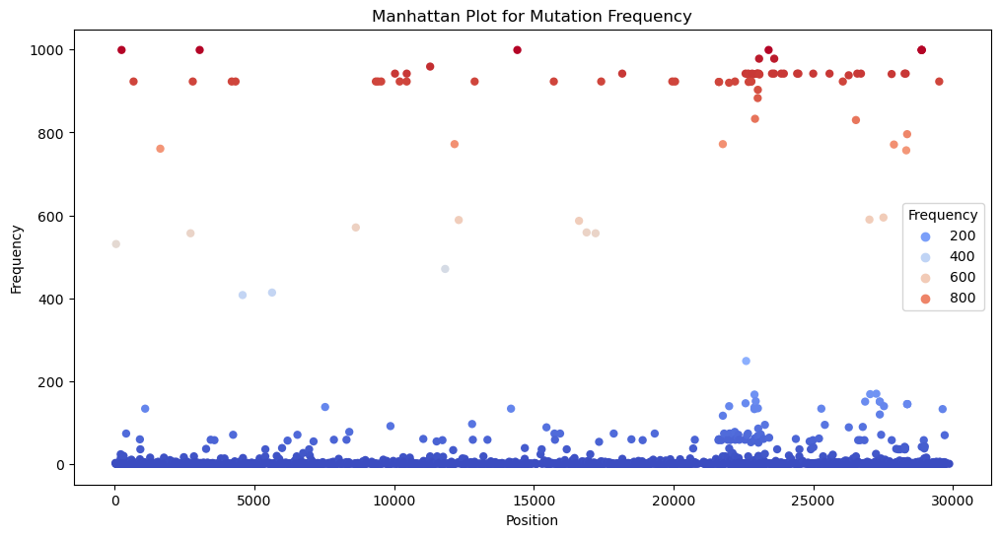

In [6]:
# Prepare data for Manhattan plot
mutation_freq = df.groupby("POS").size().reset_index(name="Frequency")

# Manhattan plot
plt.figure(figsize=(12, 6))
sns.scatterplot(data=mutation_freq, x="POS", y="Frequency", hue="Frequency", palette="coolwarm", edgecolor="none")
plt.title("Manhattan Plot for Mutation Frequency")
plt.xlabel("Position")
plt.ylabel("Frequency")
plt.legend(title="Frequency")
plt.show()

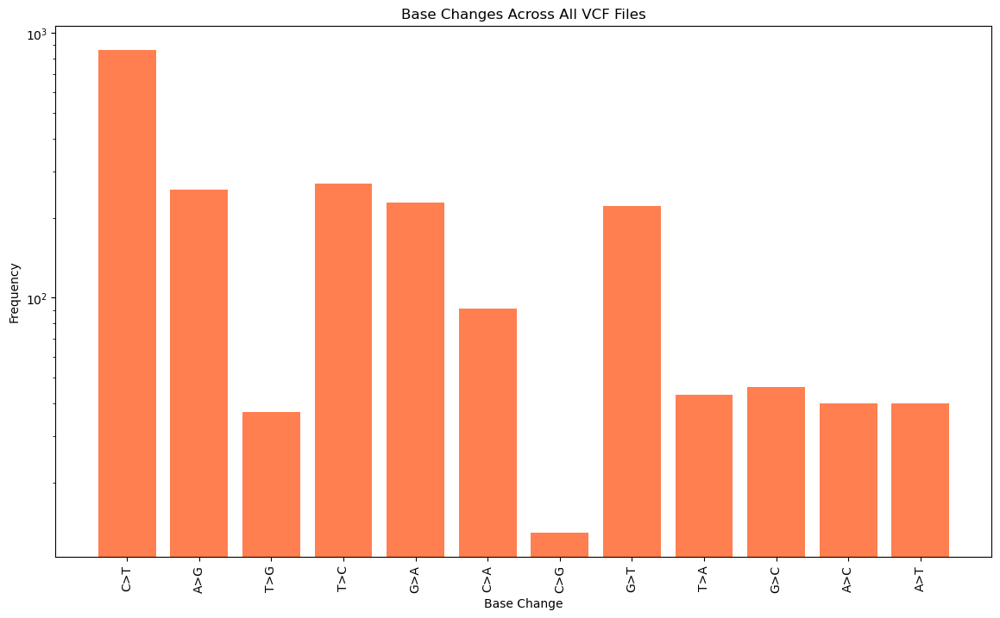

In [15]:
import matplotlib.pyplot as plt
import pandas as pd

base_change_counts = {}

df = df.drop_duplicates()

# Loop through the DataFrame and count the base changes
for _, row in df.iterrows():
    ref = row["REF"]
    alt = row["ALT"]

    # Ensure REF and ALT are valid nucleotides or deletions
    if pd.notna(ref) and pd.notna(alt):
        if ref in valid_bases and alt in valid_bases:
            # Handle deletions
            if ref == "-":
                base_change = f"Δ>{alt}"
            elif alt == "-":
                base_change = f"{ref}>Δ"
            else:
                base_change = f"{ref}>{alt}"

            # Update the count in the dictionary
            base_change_counts[base_change] = base_change_counts.get(base_change, 0) + 1

# Plotting the bar chart
plt.figure(figsize=(14, 8))
plt.bar(base_change_counts.keys(), base_change_counts.values(), color='coral')
plt.title("Base Changes Across All VCF Files")
plt.xlabel("Base Change")
plt.ylabel("Frequency")
plt.xticks(rotation=90)
plt.yscale("log")  # Use log scale for better visualization of wide frequency ranges
plt.show()


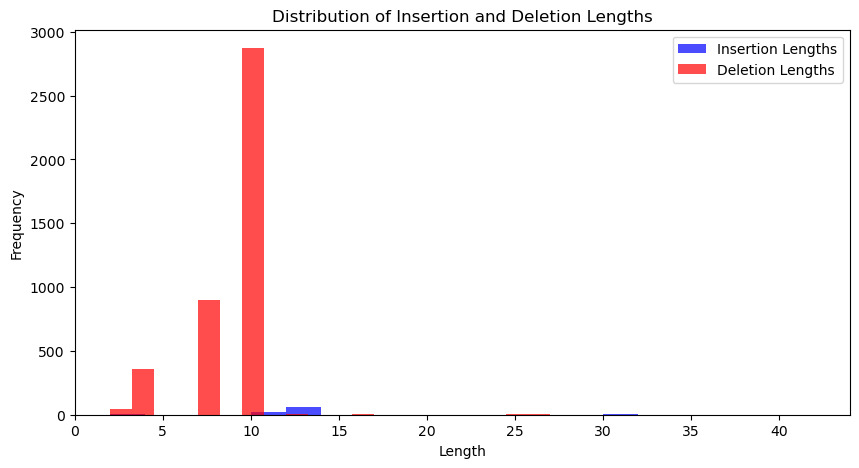

In [13]:
insertions = df[df["TYPE"] == "INSERT"]
deletions = df[df["TYPE"] == "DELETE"]

insertion_lengths = insertions["ALT"].str.len()
deletion_lengths = deletions["REF"].str.len()

# Plot histograms for insertions and deletions
plt.figure(figsize=(10, 5))
plt.hist(insertion_lengths, bins=20, color='blue', alpha=0.7, label="Insertion Lengths")
plt.hist(deletion_lengths, bins=20, color='red', alpha=0.7, label="Deletion Lengths")
plt.title("Distribution of Insertion and Deletion Lengths")
plt.xlabel("Length")
plt.ylabel("Frequency")
plt.legend()
plt.show()

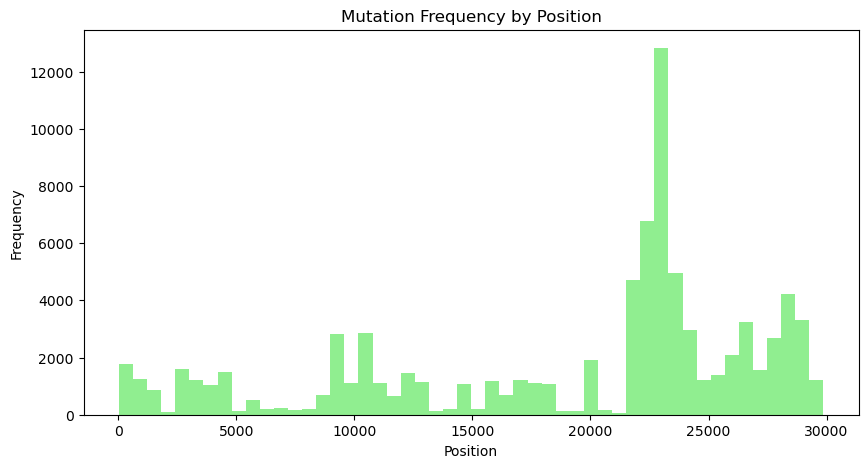

In [14]:
positions = df['POS']  # Use positions from the last file processed as an example
plt.figure(figsize=(10, 5))
plt.hist(positions, bins=50, color='lightgreen')
plt.title("Mutation Frequency by Position")
plt.xlabel("Position")
plt.ylabel("Frequency")
plt.show()

/Users/mohanavenkataphaneendrareddyalla/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


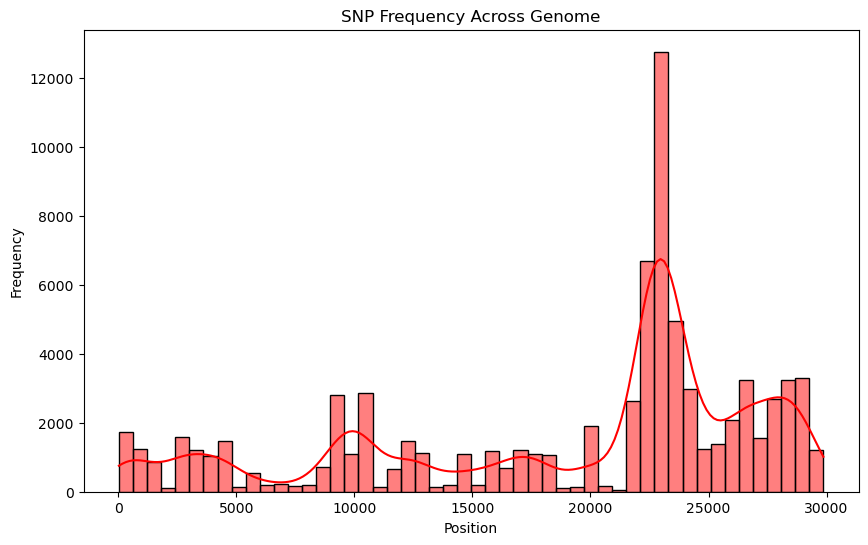

In [18]:
# Filter SNPs only
snps = df[df["TYPE"] == "SUBSTITUTE"]
plt.figure(figsize=(10, 6))
sns.histplot(snps["POS"], bins=50, color="red", kde=True)
plt.title("SNP Frequency Across Genome")
plt.xlabel("Position")
plt.ylabel("Frequency")
plt.show()

/Users/mohanavenkataphaneendrareddyalla/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


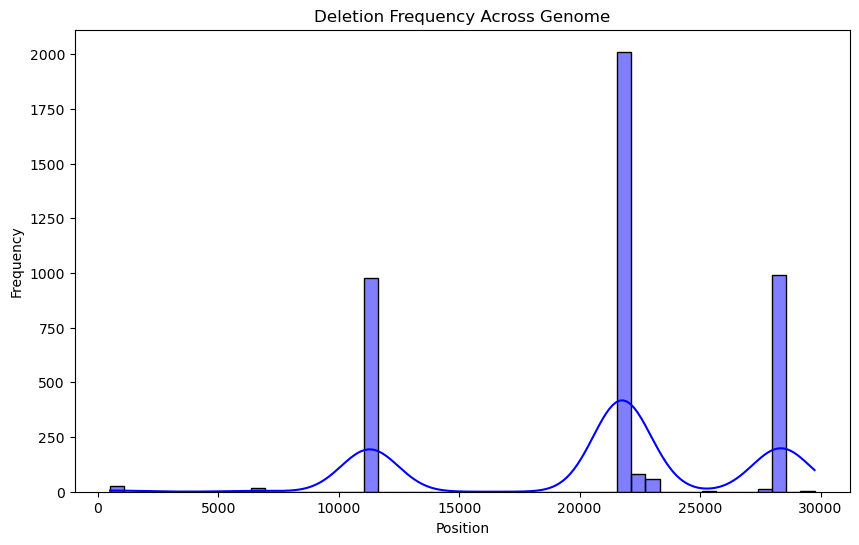

In [20]:
# Filter for Deletions and Insertions
deletions = df[df["TYPE"] == "DELETE"]
plt.figure(figsize=(10, 6))
sns.histplot(deletions["POS"], bins=50, color="blue", kde=True)
plt.title("Deletion Frequency Across Genome")
plt.xlabel("Position")
plt.ylabel("Frequency")
plt.show()

/Users/mohanavenkataphaneendrareddyalla/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


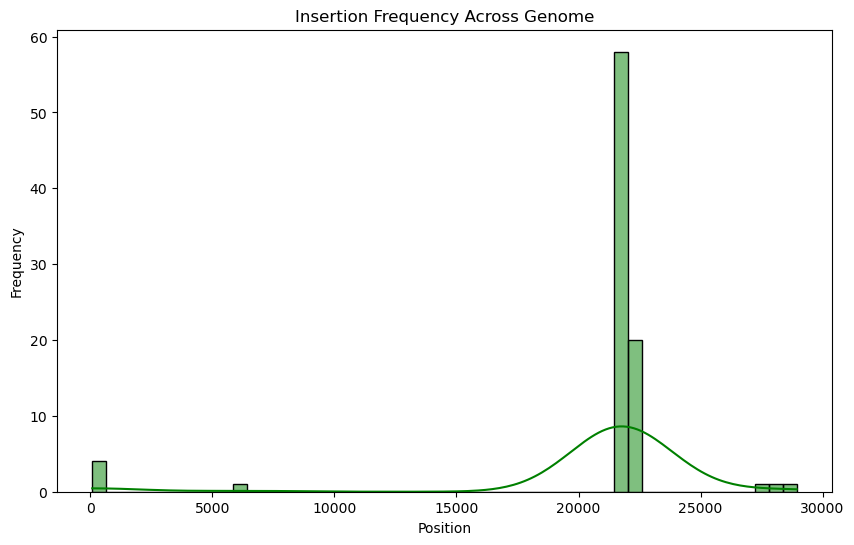

In [22]:
# Histogram for Insertion frequency
insertions = df[df["TYPE"] == "INSERT"]
plt.figure(figsize=(10, 6))
sns.histplot(insertions["POS"], bins=50, color="green", kde=True)
plt.title("Insertion Frequency Across Genome")
plt.xlabel("Position")
plt.ylabel("Frequency")
plt.show()

# Establish a statistical model (use negative binomial distributions) to report the positions of frequently observed mutations (with certain significant level as 0.0001, e.g. the p-value < 0.0001).


Estimated r: 0.0559
Estimated p: 0.0014


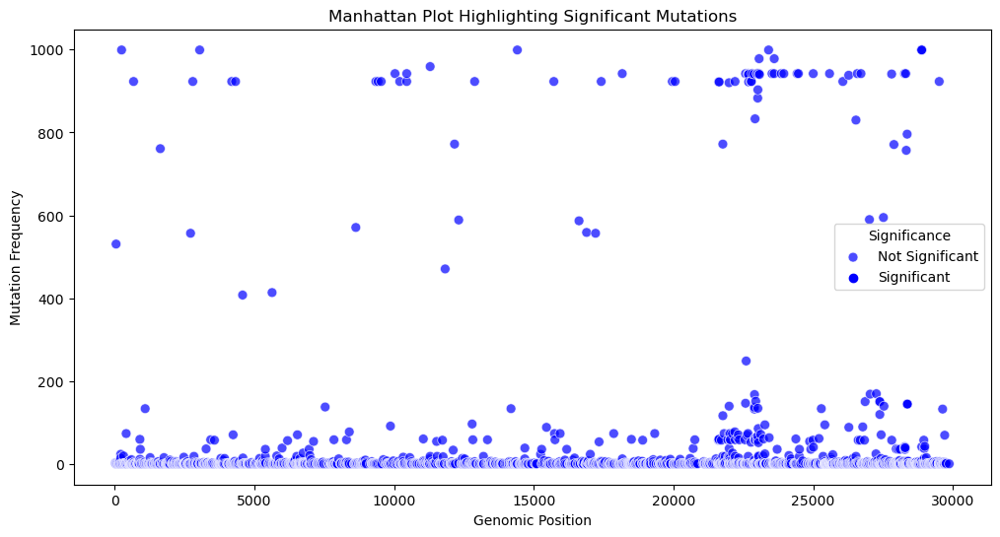

In [47]:
import numpy as np
import pandas as pd
from scipy.stats import nbinom
import matplotlib.pyplot as plt
import seaborn as sns



mutation_counts = df.groupby("POS").size().reset_index(name="Frequency")


freq_data = mutation_counts["Frequency"].values
mean_freq = np.mean(freq_data)
var_freq = np.var(freq_data)


r = (mean_freq ** 2) / (var_freq - mean_freq)
p = r / (r + mean_freq)

print(f"Estimated r: {r:.4f}")
print(f"Estimated p: {p:.4f}")

mutation_counts["p_value"] = 1 - nbinom.cdf(mutation_counts["Frequency"] - 1, r, p)

mutation_counts["Significance"] = mutation_counts["p_value"] < 0.0001

plt.figure(figsize=(12, 6))
sns.scatterplot(
    data=mutation_counts, 
    x="POS", 
    y="Frequency", 
    hue="Significance",
    palette={True: "red", False: "blue"}, 
    s=50,         
    alpha=0.7,     
    edgecolor="white" 
)

plt.title("Manhattan Plot Highlighting Significant Mutations")
plt.xlabel("Genomic Position")
plt.ylabel("Mutation Frequency")
plt.legend(title="Significance", labels=["Not Significant", "Significant"])
plt.show()


In [69]:
import pandas as pd
import networkx as nx
import random


mst_path = "/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/project/for_step_7_mutation_matrix/minimum_spanning_tree.csv"
genome_annotation_path = "/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/project/for_step_7_mutation_matrix/filtered_genome_annotation.csv"

mst_df = pd.read_csv(mst_path)
genome_annotation_df = pd.read_csv(genome_annotation_path)

print("Step 0: Data Loaded Successfully.")
print(f"Total Edges in MST: {len(mst_df)}")
print(f"Total Entries in Genome Annotation: {len(genome_annotation_df)}\n")

mst_df['Accession1'] = mst_df['Accession1'].str.replace(r'\.\d+$', '', regex=True)
mst_df['Accession2'] = mst_df['Accession2'].str.replace(r'\.\d+$', '', regex=True)

print("Step 1: Version suffixes removed from accession numbers.\n")


sequencing_date_lookup = genome_annotation_df.set_index('Accession')['Collection_Date'].to_dict()


G = nx.Graph()
for _, row in mst_df.iterrows():
    G.add_edge(row['Accession1'], row['Accession2'], weight=row['Weight'])

print("Step 2: Graph created from MST DataFrame.")
print(f"Total Nodes in Graph: {len(G.nodes)}")
print(f"Total Edges in Graph: {len(G.edges)}\n")


def bfs_levels(graph, start_node):
    levels = {}
    queue = [(start_node, 0)]
    visited = set()
    
    while queue:
        node, level = queue.pop(0)
        if node not in visited:
            visited.add(node)
            levels[node] = level
            for neighbor in graph.neighbors(node):
                if neighbor not in visited:
                    queue.append((neighbor, level + 1))
    
    return levels


start_node = random.choice(list(G.nodes))
print(f"Step 3: Performing BFS starting from node: {start_node}\n")
levels = bfs_levels(G, start_node)


print("Sample Node Levels (First 10 Nodes):")
for node, level in list(levels.items())[:10]:
    print(f"{node}: Level {level}")
print("\n")

results = []
success_count = 0
total_count = 0

for node1, node2 in G.edges():
    if levels[node1] < levels[node2]:
        parent, child = node1, node2
    else:
        parent, child = node2, node1

    parent_date = sequencing_date_lookup.get(parent)
    child_date = sequencing_date_lookup.get(child)

    if parent_date and child_date:
        total_count += 1
        status = "True" if parent_date <= child_date else "False"
        if status == "True":
            success_count += 1
        
        results.append({
            "Parent": parent,
            "Child": child,
            "Parent_Collection_Date": parent_date,
            "Child_Collection_Date": child_date,
            "Status": status
        })

print("Step 4: Sequencing Order Check Completed.")
print(f"Total Parent-Child Pairs Checked: {total_count}")
print(f"Success Count (True): {success_count}")
print(f"Failure Count (False): {total_count - success_count}")
print(f"Success Rate: {success_count / total_count:.2%}\n")

# Step 5: Save results to CSV
results_df = pd.DataFrame(results)
output_path = "mst_sequencing_order_results.csv"
results_df.to_csv(output_path, index=False)

print(f"Step 5: Results saved to '{output_path}'.")

def calculate_average_success_rate(G, sequencing_date_lookup, iterations=1000, sample_size=1000):
    success_rates = []
    nodes = list(G.nodes)

    for i in range(iterations):
        sampled_nodes = random.sample(nodes, min(sample_size, len(nodes)))
        sampled_graph = G.subgraph(sampled_nodes)
        
        success_count = 0
        total_count = 0
        
        start_node = random.choice(list(sampled_graph.nodes))
        levels = bfs_levels(sampled_graph, start_node)

        for node1, node2 in sampled_graph.edges():
            if levels[node1] < levels[node2]:
                parent, child = node1, node2
            else:
                parent, child = node2, node1

            parent_date = sequencing_date_lookup.get(parent)
            child_date = sequencing_date_lookup.get(child)

            if parent_date and child_date:
                total_count += 1
                if parent_date <= child_date:
                    success_count += 1
        
        success_rate = success_count / total_count if total_count > 0 else 0
        success_rates.append(success_rate)
        
        if (i + 1) % 100 == 0:
            print(f"Iteration {i + 1}/{iterations}: Success Rate = {success_rate:.2%}")

    # Calculate the average success rate
    average_success_rate = sum(success_rates) / len(success_rates)
    return average_success_rate

print("\nStep 6: Repeating the process 1000 times with random subsets...")
average_success_rate = calculate_average_success_rate(G, sequencing_date_lookup, iterations=1000, sample_size=1000)

print(f"\nAverage Success Rate over 1000 iterations: {average_success_rate:.2%}")


Step 0: Data Loaded Successfully.
Total Edges in MST: 998
Total Entries in Genome Annotation: 33918

Step 1: Version suffixes removed from accession numbers.

Step 2: Graph created from MST DataFrame.
Total Nodes in Graph: 999
Total Edges in Graph: 998

Step 3: Performing BFS starting from node: PQ105535

Sample Node Levels (First 10 Nodes):
PQ105535: Level 0
BS014797: Level 1
PQ101772: Level 2
BS016038: Level 2
PQ105580: Level 2
PQ104639: Level 2
PQ106126: Level 2
PQ106163: Level 2
PQ105681: Level 2
PQ105215: Level 2


Step 4: Sequencing Order Check Completed.
Total Parent-Child Pairs Checked: 998
Success Count (True): 882
Failure Count (False): 116
Success Rate: 88.38%

Step 5: Results saved to 'mst_sequencing_order_results.csv'.

Step 6: Repeating the process 1000 times with random subsets...
Iteration 100/1000: Success Rate = 88.38%
Iteration 200/1000: Success Rate = 88.38%
Iteration 300/1000: Success Rate = 88.38%
Iteration 400/1000: Success Rate = 88.38%
Iteration 500/1000: Succe

In [11]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt


df = pd.read_csv('/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/project/for_step_7_mutation_matrix/minimum_spanning_tree.csv')

G = nx.Graph()
for index, row in df.iterrows():
    G.add_edge(row['Accession1'], row['Accession2'], weight=row['Weight'])

mst = nx.minimum_spanning_tree(G)

extended_mst = mst.copy()
for u, v, data in G.edges(data=True):
    if not extended_mst.has_edge(u, v):
        extended_mst.add_edge(u, v, weight=data['Weight'])


root_node = 'NC_045512'


pos = nx.spring_layout(extended_mst, seed=42, center=(0, 0))
pos[root_node] = (0, 0)  # Fix root node at a central position

node_color = 'skyblue'
node_size = 800


edge_colors = ['green' if extended_mst[u][v]['weight'] < 10 else 'orange' for u, v in extended_mst.edges()]
edge_weights = [extended_mst[u][v]['weight'] for u, v in extended_mst.edges()]
edge_widths = [1 + (weight / 10) for weight in edge_weights]


plt.figure(figsize=(36, 24), dpi=300)  # Large figure size and high DPI for high resolution


nx.draw_networkx_nodes(extended_mst, pos, node_size=node_size, node_color=node_color, edgecolors='black')


nx.draw_networkx_edges(extended_mst, pos, width=edge_widths, edge_color=edge_colors)


nx.draw_networkx_labels(extended_mst, pos, font_size=18, font_color='darkblue', font_weight='bold')


edge_labels = nx.get_edge_attributes(extended_mst, 'weight')
nx.draw_networkx_edge_labels(extended_mst, pos, edge_labels=edge_labels, font_size=14, font_color='red')


plt.text(0.85, 0.1, 'Edge Colors:', fontsize=16, transform=plt.gcf().transFigure)
plt.text(0.85, 0.08, 'Green = Weight < 10', fontsize=14, transform=plt.gcf().transFigure, color='green')
plt.text(0.85, 0.06, 'Orange = Weight ≥ 10', fontsize=14, transform=plt.gcf().transFigure, color='orange')


plt.title('Extended Minimum Spanning Tree (MST) with Root Node NC_045512', fontsize=24)
plt.axis('off')
plt.tight_layout()


plt.savefig('/Users/mohanavenkataphaneendrareddyalla/Desktop/Adv_comp_asspects_in_bioinfo/project_final/extended_mst_high_res.png', dpi=300, bbox_inches='tight')


plt.show()
